In [23]:
import os, io
from flask import Flask, flash, request, send_from_directory
from flask_cors import CORS, cross_origin
from pathlib import Path
from PIL import Image
from bitarray import bitarray
import numpy as np
import json
import imagehash
import tensorflow as tf
from pathlib import Path
from PIL import Image
import time
from io import BytesIO 
PATH_TO_FROZEN_GRAPH = 'freeze/frozen_inference_graph.pb'

In [19]:
def get_session(detection_graph):
    sess = tf.Session(graph=detection_graph)
    return sess

def get_detection_graph(PATH_TO_FROZEN_GRAPH):
    detection_graph = tf.Graph()
    with detection_graph.as_default():
        od_graph_def = tf.GraphDef()
        with tf.gfile.GFile(PATH_TO_FROZEN_GRAPH, 'rb') as fid:
            serialized_graph = fid.read()
            od_graph_def.ParseFromString(serialized_graph)
            tf.import_graph_def(od_graph_def, name='')
    return detection_graph

def run_inference_for_single_image(image, graph, sess):
    keys = ['num_detections', 'detection_boxes', 'detection_scores', 'detection_classes']
    tensor_dict = {key: key+':0' for key in keys}
    image_tensor = detection_graph.get_tensor_by_name('image_tensor:0')
    image_np = np.array(image)
    image_np_expanded = np.expand_dims(image, axis=0)
    start_time = time.time()
    # Run inference
    output_dict = sess.run(
        tensor_dict,
        feed_dict={image_tensor: image_np_expanded})
    # all outputs are float32 numpy arrays, so convert types as appropriate
    output_dict['num_detections'] = int(output_dict['num_detections'][0])
    output_dict['detection_classes'] = output_dict[
      'detection_classes'][0].astype(np.uint8)
    output_dict['detection_boxes'] = output_dict['detection_boxes'][0]
    output_dict['detection_scores'] = output_dict['detection_scores'][0]
    print(time.time() - start_time)
    return output_dict



def crop_image(image, detection_graph, sess):
    output_dict = run_inference_for_single_image(image, detection_graph, sess)
    width, height = image.size
    y1 =  int(height*output_dict['detection_boxes'][0][0])
    x1 =  int (width*output_dict['detection_boxes'][0][1])
    y2 = int(height*output_dict['detection_boxes'][0][2])
    x2 = int(width*output_dict['detection_boxes'][0][3])
    c_image = image.crop(( x1,y1, x2, y2))
    b = BytesIO()
    c_image.save(b,format="jpeg")
    crop_image = Image.open(b)
    return crop_image
    


In [20]:
image = Image.open("testdata/IMG_8454.JPG")

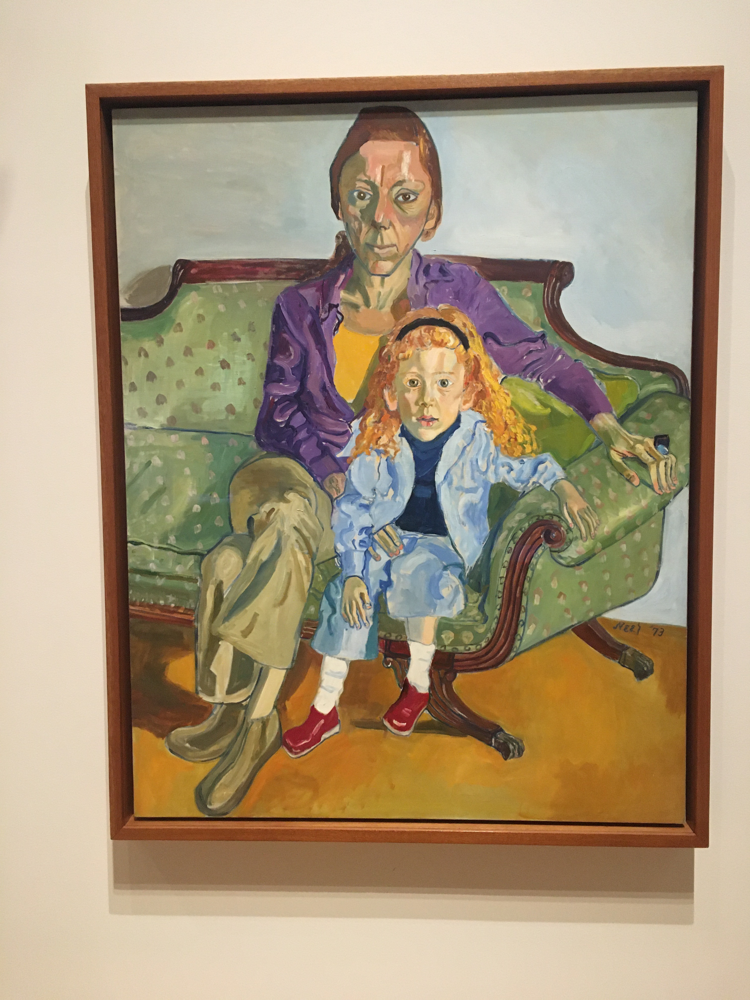

In [21]:
image

In [24]:
detection_graph = get_detection_graph(PATH_TO_FROZEN_GRAPH)
session = get_session(detection_graph)
cropped_image = crop_image(image, detection_graph, session)

3.5441629886627197


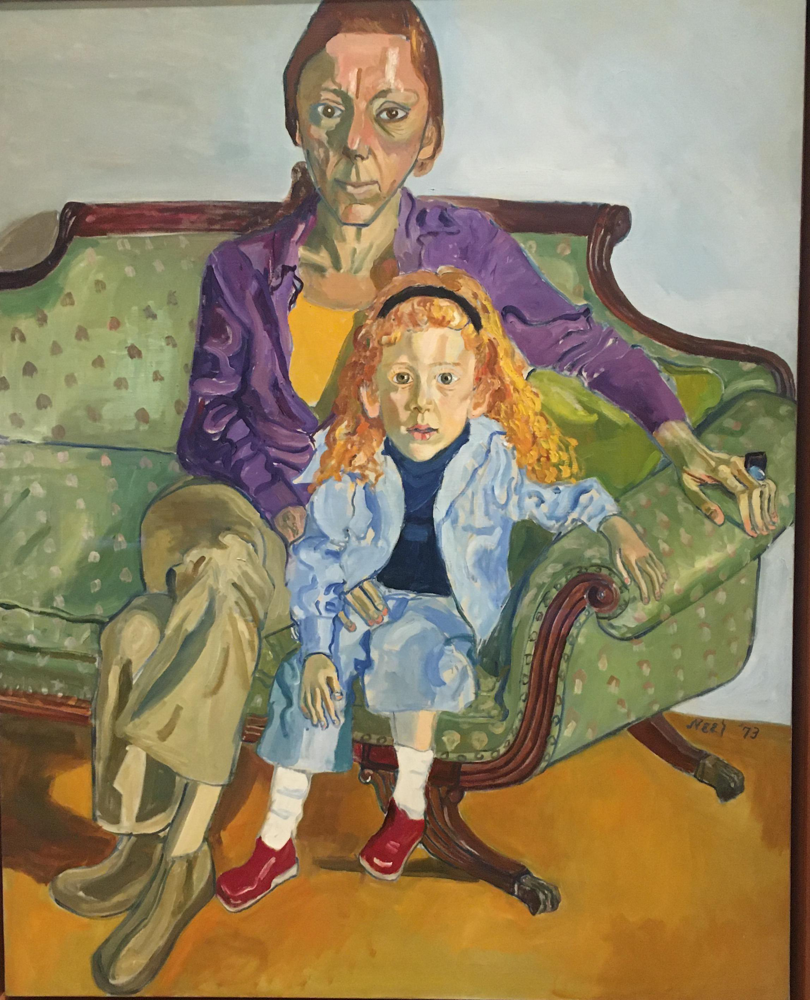

In [25]:
cropped_image